In [ ]:
!pip install pyworld
!pip install pretty_midi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.0/261.0 kB 5.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pyworld: filename=pyworld-0.3.5-cp311-cp311-linux_x86_64.whl size=924413 sha256=137f736030b818883a302e111cddf98bd78d186f85b5d496faf23bd53614e321
  Stored in directory: /root/.cache/pip/wheels/26/f0/db/ebcd5cdfe5ad7d229917d3a8db6f18f0cf40f099bf878e294d
Successfully built pyworld
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 42.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 kB 4.2 MB/s eta 0:00:00
  Created wheel for pretty_midi: filename=pretty_midi-0.2.10-py3-none-any.whl size=5592286 sha256=05e097ffefcc15402ae54ccfdc4d8ac70a27f9533826d16ebeaf56e07e6f4c8a
  Stored in directory: /root/.cache/pip/wheels/e6/95/ac/15ceaeb2823b04d8e638fd1495357adb8d26c00ccac9d7782e
Successfully buil

In [ ]:
import numpy as np
import librosa
import pyworld as pw
import matplotlib.pyplot as plt
import pandas as pd
import joblib
import numpy as np
import pretty_midi
import soundfile as sf

In [ ]:
def extract_features(y, sr):
    y = y.astype(np.float64)

    # === Use librosa.pyin's default frame_length and hop_length ===
    # Default frame_length = 2048, default hop_length = frame_length // 4 = 512
    pyin_hop_length = 2048 // 4 # Explicitly define for clarity
    pyin_frame_length = 2048

    # === Extract F0 using librosa.pyin ===
    f0, voiced_flag, _ = librosa.pyin(
        y, sr=sr,
        fmin=librosa.note_to_hz('C2'),
        fmax=librosa.note_to_hz('C7'),
        frame_length=pyin_frame_length, # Using default
        hop_length=pyin_hop_length    # Using default
    )

    # === Create accurate timestamps for F0 ===
    times_f0 = librosa.times_like(f0, sr=sr, hop_length=pyin_hop_length)

    # === Clean F0 ===
    f0_clean = f0.copy()
    mask = np.isnan(f0_clean) | (f0_clean == 0)
    if np.any(mask):
        # Ensure there are valid points to interpolate from
        valid_indices = np.flatnonzero(~mask)
        nan_indices = np.flatnonzero(mask)
        if len(valid_indices) > 0:
            f0_clean[mask] = np.interp(nan_indices, valid_indices, f0_clean[valid_indices])
        else: # All values are NaN or zero, fill with zero
            f0_clean[mask] = 0.0
    f0_clean = np.nan_to_num(f0_clean, nan=0.0) # Final check for any remaining NaNs

    # === RMS energy, aligned to the same hop rate ===
    # Use the same frame_length and hop_length as pyin for consistency
    rms = librosa.feature.rms(y=y, frame_length=pyin_frame_length, hop_length=pyin_hop_length)[0]

    # Align lengths (truncate/pad if librosa.feature.rms produces slightly different num_frames)
    min_len = min(len(f0_clean), len(rms))
    f0_clean = f0_clean[:min_len]
    times_f0 = times_f0[:min_len]
    rms = rms[:min_len]

    # === Spectral envelope ===
    # Ensure f0_clean has 0 for unvoiced for cheaptrick
    f0_for_cheaptrick = f0_clean.copy()

    sp = pw.cheaptrick(y, f0_for_cheaptrick, times_f0, sr)

    # === Aperiodicity (needed for pyWORLD synthesis of vibrato) ===
    ap = pw.d4c(y, f0_for_cheaptrick, times_f0, sr)

    return times_f0, f0_clean, rms, sp, ap, (pyin_hop_length / sr)

In [ ]:
note_boundaries = [ # These were manually extracted from CSD time-aligned MIDI files
    (3.873, 4.590),
    (4.614, 5.329),
    (5.353, 7.453),
    (7.820, 8.680),
    (9.106, 9.560),
    (9.794, 10.247),
    (10.480, 12.820),
    (14.180, 14.667),
    (14.920, 15.406),
    (15.653, 17.240),
    (18.027, 18.806),
    (19.200, 19.660),
    (19.894, 20.353),
    (20.586, 21.540),
    (22.027, 22.867),
    (23.294, 24.147),
    (24.580, 25.414),
    (25.827, 26.394),
    (26.686, 26.873),
    (26.973, 27.406),
    (27.633, 28.067),
    (28.294, 29.214),
    (29.680, 30.667),
    (31.167, 33.827),
    (35.073, 35.533),
    (35.773, 36.233),
    (36.467, 37.127),
    (37.460, 37.680),
    (37.794, 38.220),
    (38.433, 38.860),
    (39.080, 39.527),
    (39.753, 40.200),
    (40.427, 40.873),
    (41.100, 41.547),
    (41.773, 43.367),
    (44.180, 45.100),
    (45.560, 46.020),
    (46.260, 46.720),
    (46.953, 47.580),
    (47.900, 48.106),
    (48.220, 48.620),
    (48.820, 49.220),
    (49.427, 49.847),
    (50.067, 50.486),
    (50.706, 51.180),
    (51.420, 51.894),
    (52.133, 52.947),
    (53.353, 54.240),
    (54.686, 55.560),
    (56.000, 56.820),
    (57.233, 57.906),
    (58.253, 58.480),
    (58.586, 59.067),
    (59.320, 59.800),
    (60.047, 60.960),
    (61.414, 62.500),
    (63.053, 65.767),
    (67.253, 67.660),
    (67.867, 68.273),
    (68.480, 71.527),
    (71.100, 71.973),
    (72.406, 72.880),
    (73.120, 73.594),
    (73.833, 77.706),
    (77.714, 78.140),
    (78.367, 78.793),
    (79.014, 81.406),
    (81.414, 81.827),
    (82.667, 83.114),
    (83.340, 83.786),
    (84.020, 84.853),
    (85.273, 86.153),
    (86.600, 87.420),
    (87.833, 88.680),
    (89.106, 89.740),
    (90.060, 90.273),
    (90.380, 90.814),
    (91.033, 91.467),
    (91.686, 92.686),
    (93.193, 94.186),
    (94.680, 98.859),
    (98.867, 99.273),
    (99.486, 99.893),
    (100.106, 100.733),
    (101.059, 101.267),
    (101.373, 101.806),
    (102.033, 102.467),
    (102.693, 103.120),
    (103.340, 103.767),
    (103.993, 104.447),
    (104.680, 105.133),
    (105.373, 108.453),
    (107.920, 108.993),
    (109.533, 109.940),
    (110.147, 110.553),
    (110.759, 111.406),
    (111.733, 111.947),
    (112.059, 112.467),
    (112.673, 113.080),
    (113.286, 113.706),
    (113.926, 114.347),
    (114.567, 115.020),
    (115.253, 115.706),
    (115.940, 116.880),
    (117.359, 118.220),
    (118.647, 119.640),
    (120.140, 121.020),
    (121.459, 122.180),
    (122.547, 122.786),
    (122.906, 123.386),
    (123.633, 124.114),
    (124.359, 125.414),
    (125.947, 127.420),
    (128.153, 129.959)
]

In [ ]:
vib_depth_model = joblib.load('/content/drive/MyDrive/vibrato_depth_model.pkl')
vib_rate_model = joblib.load('/content/drive/MyDrive/vibrato_rate_model.pkl')

In [ ]:
def apply_vibrato_transformation(
    y,
    voice_part,
    note_boundaries,
    vib_depth_model,
    vib_rate_model,
    sr,
    hop_size=512,
    fade_time=0.03  # seconds
):

    frame_period = hop_size / sr * 1000
    fade_len = int(fade_time * sr)

    output = y.copy()

    for start_sec, end_sec in note_boundaries:
        print(f"Doing note from {start_sec} to {end_sec} sec")

        start_sample = int(start_sec * sr)
        end_sample = int(end_sec * sr)
        y_note = y[start_sample:end_sample]

        # === Pitch and features ===
        _, f0, rms, sp, ap, _ = extract_features(y_note, sr)

        if len(f0) < 5 or np.all(f0 == 0):
            continue

        # === Ensure y_note matches f0 length ===
        expected_len = hop_size * len(f0)
        y_note = y_note[:expected_len]

        # === Predict vibrato depth and rate directly ===
        mean_f0 = np.mean(f0[f0 > 0])
        mean_rms = np.mean(rms)
        duration = end_sec - start_sec

        x = np.array([[mean_f0, mean_rms, duration, voice_part]])

        vib_depth = vib_depth_model.predict(x)[0]
        print(f"Predicted vibrato depth: {vib_depth}")

        vib_rate = vib_rate_model.predict(x)[0]
        print(f"Predicted vibrato rate: {vib_rate}")

        # === Inject vibrato ===
        t = np.arange(len(f0)) * (hop_size / sr)
        vibrato = (vib_depth / 2) * np.sin(2 * np.pi * vib_rate * t)
        f0_modified = f0 + vibrato

        # === Synthesize ===
        y_note_transformed = pw.synthesize(f0_modified, sp, ap, sr, frame_period=frame_period)
        y_note_transformed = y_note_transformed[:expected_len]

        # === Crossfade with original ===
        original_segment = output[start_sample:start_sample + expected_len]
        blend = np.ones(expected_len)

        if fade_len * 2 < expected_len:
            fade_in = np.linspace(0, 1, fade_len)
            fade_out = fade_in[::-1]
            blend[:fade_len] = fade_in
            blend[-fade_len:] = fade_out

        # Ensure all segments are equal in length to prevent broadcasting errors
        min_len = min(len(y_note_transformed), len(original_segment), len(blend))
        y_note_transformed = y_note_transformed[:min_len]
        original_segment = original_segment[:min_len]
        blend = blend[:min_len]

        output[start_sample:start_sample + min_len] = (
            y_note_transformed * blend + original_segment * (1 - blend)
        )

    return output

In [ ]:
file_path = "/content/drive/MyDrive/data/ChoralSingingDataset/CSD_ER_alto_4.wav"

In [ ]:
y = librosa.load(file_path, sr=44100)[0]

In [ ]:
sr = 44100
import IPython.display as ipd
ipd.Audio(y, rate=sr)

In [ ]:
# === Apply transformation ===
y_transformed = apply_vibrato_transformation(
    y,
    3,
    note_boundaries,
    vib_depth_model,
    vib_rate_model,
    sr,
    hop_size=512,
    fade_time=0.03  # seconds
)

Doing note from 3.873 to 4.59 sec
Predicted vibrato depth: 10.891843589657661
Predicted vibrato rate: 4.337229670649633
Doing note from 4.614 to 5.329 sec
Predicted vibrato depth: 9.88234406658381
Predicted vibrato rate: 4.193260041412443
Doing note from 5.353 to 7.453 sec
Predicted vibrato depth: 6.781272901374296
Predicted vibrato rate: 4.100721849149061
Doing note from 7.82 to 8.68 sec
Predicted vibrato depth: 8.124697020250583
Predicted vibrato rate: 6.296185529279014
Doing note from 9.106 to 9.56 sec
Predicted vibrato depth: 11.142918187174002
Predicted vibrato rate: 4.021837855521519
Doing note from 9.794 to 10.247 sec
Predicted vibrato depth: 12.11467846627078
Predicted vibrato rate: 4.021837855521519
Doing note from 10.48 to 12.82 sec
Predicted vibrato depth: 6.871494874476305
Predicted vibrato rate: 4.334772628618164
Doing note from 14.18 to 14.667 sec
Predicted vibrato depth: 12.715568395408523
Predicted vibrato rate: 3.4434362194086225
Doing note from 14.92 to 15.406 sec
Pre

In [ ]:
import IPython.display as ipd
ipd.Audio(y_transformed, rate=sr)

In [ ]:
sf.write('/content/CSD_ER_alto_4_transformed.wav', y_transformed, sr)

In [ ]:
# Extract features for original and transformed audio
times_y, f0_y, rms_y, sp_y, ap_y, frame_period_y_sec = extract_features(y, sr)
times_y_transformed, f0_y_transformed, rms_y_transformed, sp_y_transformed, ap_y_transformed, frame_period_y_transformed_sec = extract_features(y_transformed, sr)

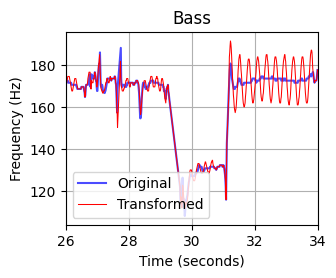

In [ ]:
f0_y_filtered = f0_y.copy()
times_y_filtered = times_y.copy()
mask_y = f0_y_filtered > 400
f0_y_filtered[mask_y] = np.nan # Replace with NaN to skip plotting

f0_y_transformed_filtered = f0_y_transformed.copy()
times_y_transformed_filtered = times_y_transformed.copy()
mask_transformed = f0_y_transformed_filtered > 400
f0_y_transformed_filtered[mask_transformed] = np.nan # Replace with NaN to skip plotting

# Plotting
plt.figure(figsize=(3.25, 2.5))

# Find indices up to x=30
indices_y = times_y_filtered <= 34
indices_transformed = times_y_transformed_filtered <= 34

# Plot original pitch contour (filtered) up to x=30
plt.plot(times_y_filtered[indices_y], f0_y_filtered[indices_y], label='Original', color='blue', alpha=0.7)

# Plot transformed pitch contour (filtered) up to x=30 with 50% opacity (alpha=0.5) and thin line
plt.plot(times_y_transformed_filtered[indices_transformed], f0_y_transformed_filtered[indices_transformed], label='Transformed', color='red', linewidth=0.75) # Added linewidth


plt.title('Bass')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.xlim(26, 34) # Set x-axis limit
plt.grid(True)
plt.legend(loc='lower left')
plt.savefig("pitch_comparison_bass.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
import soundfile as sf

sf.write('/content/CSD_ER_bass_4_transformed.wav', y_transformed, sr)